In [1]:
using Revise

In [2]:
using PseudoSpectral

[ Info: Precompiling PseudoSpectral [bd83d689-c64f-4c1b-b0f0-b24758136900]


In [3]:
using Plots
using LinearAlgebra
using FFTW

In [4]:
Nx, Ny = 16, 32
x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny);

### Zero pad in the x direction only

In [114]:
f = rand(Nx,Ny+1)
fhat = physical2fourier(f,1);

In [111]:
f2 = fourier2physical(fhat,1);

In [112]:
norm(f-f2)

1.898976363167973e-15

In [108]:
Nxpad = ceil(Int,3*Nx/2)
Nypad = Ny+1

33

In [109]:
fpad = zeropad(fhat,(Nxpad,Nypad))

24×33 Matrix{ComplexF64}:
   8.76905+0.0im          7.69179+0.0im       …    8.44236+0.0im
  -1.05386-0.53194im     0.592558-1.19962im       0.494981-0.717658im
 -0.431326+0.0061388im  -0.213047+0.162365im     -0.575179-0.318335im
    1.5451-1.12384im     -1.31981+0.830102im     -0.347751+0.968699im
  -0.33322-0.485246im    0.255852+0.152231im      -1.27251-1.07716im
 -0.115306-1.03887im     0.908507-0.205102im  …   0.940791+0.0846874im
  0.216686+1.34341im    -0.420817-0.390555im     -0.355699+0.510295im
 -0.047291+0.6716im        3.4182-0.665712im       -1.1364-0.48968im
       0.0+0.0im              0.0+0.0im                0.0+0.0im
       0.0+0.0im              0.0+0.0im                0.0+0.0im
       0.0+0.0im              0.0+0.0im       …        0.0+0.0im
       0.0+0.0im              0.0+0.0im                0.0+0.0im
       0.0+0.0im              0.0+0.0im                0.0+0.0im
       0.0+0.0im              0.0+0.0im                0.0+0.0im
       0.0+0.0im              

In [110]:
fhat2 = unzeropad(fpad,(Nx,Ny+1))
fhat2 == fhat

true

### Apply Chebyshev differentiation 

In [236]:
x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny);

f = cos.(2*x).*(1 .- 2*transpose(y).^2);
fhat = physical2fourier(f,1)
fchat = fchebt(fhat,2)
fhat2 = ifchebt(fchat,2)
f2 = fourier2physical(fhat2,1)

16×33 Matrix{Float64}:
 -1.0          -0.980785     -0.92388      …  -0.980785     -1.0
 -0.707107     -0.69352      -0.653281        -0.69352      -0.707107
 -6.12323e-17  -6.00558e-17  -5.65713e-17     -6.00558e-17  -6.12323e-17
  0.707107      0.69352       0.653281         0.69352       0.707107
  1.0           0.980785      0.92388          0.980785      1.0
  0.707107      0.69352       0.653281     …   0.69352       0.707107
  1.83697e-16   1.80167e-16   1.69714e-16      1.80167e-16   1.83697e-16
 -0.707107     -0.69352      -0.653281        -0.69352      -0.707107
 -1.0          -0.980785     -0.92388         -0.980785     -1.0
 -0.707107     -0.69352      -0.653281        -0.69352      -0.707107
 -3.06162e-16  -3.00279e-16  -2.82857e-16  …  -3.00279e-16  -3.06162e-16
  0.707107      0.69352       0.653281         0.69352       0.707107
  1.0           0.980785      0.92388          0.980785      1.0
  0.707107      0.69352       0.653281         0.69352       0.707107
  4.2862

In [237]:
D1 = PseudoSpectral._construct_chebd1(Ny)
D2 = PseudoSpectral._construct_chebd2(Ny,D1);

Rows of `fhat` correspond to Fourier components. To differentiate one Fourier component along the y direction: 

In [263]:
x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny);

f = cos.(2*x).*(1 .- 2*transpose(y).^2);
fhat = physical2fourier(f,1)
dfhat = PseudoSpectral._dfhatdx(fhat)
#fchat = fchebt(fhat,2)
#fhat2 = ifchebt(fchat,2)
f2 = fourier2physical(dfhat,1);

In [267]:
d2fdxdy = transpose(D1*transpose(f2));

In [260]:
contour(x,f2[:,1])

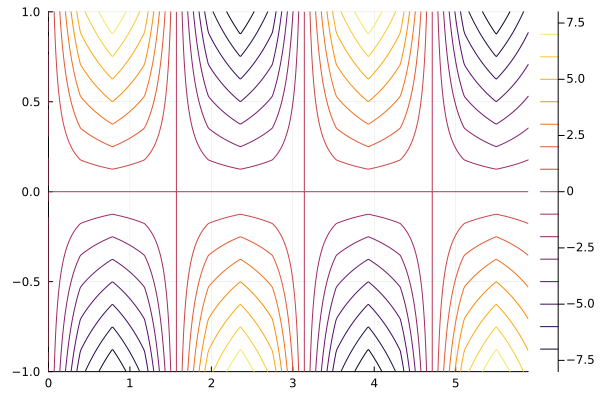

In [270]:
contour(x,reverse(y),transpose(reverse(d2fdxdy,dims=2)))

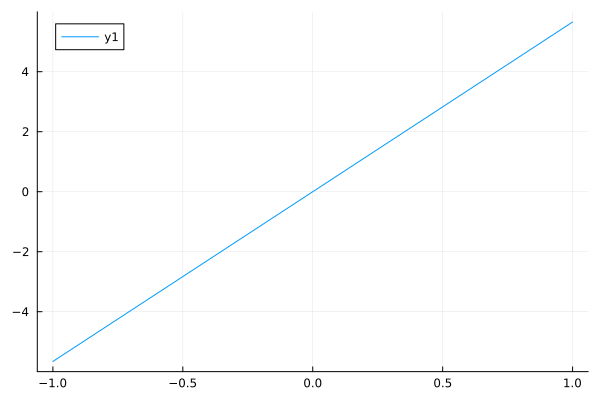

In [272]:
plot(y,d2fdxdy[10,:])

### Apply Fourier differentiation

In [170]:
Nx, Ny = 16, 16

x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny);

f = cos.(2*x).*sin.(π*transpose(y));
dfex = -2*sin.(2*x).*sin.(π*transpose(y));

fhat = physical2fourier(f,1);
dfhat = PseudoSpectral._dfhatdx_fourier(fhat);

df = fourier2physical(dfhat,1);

### Get streamfunction and velocity from vorticity
Let's suppose the vorticity is given by

$$\omega(x,y) = y$$

Then the expected velocity is $u = (1-y^2)/2$

In [205]:
Nx, Ny = 32, 32

x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny);

#u = 0.5*ones(Nx).*(1 .- transpose(y).^2);
#ω = ones(Nx).*transpose(y);
ω = cos.(2*x).*transpose(y) #sin.(π*transpose(y));
ω̂ = physical2fourier(ω,1);
ψ̂ = zero(ω̂);

In [206]:
D1 = PseudoSpectral._construct_chebd1(Ny)
D2 = PseudoSpectral._construct_chebd2(Ny,D1);
gplus = 0.0*ones(Nx)
gplus_hat = physical2fourier(gplus)

gminus = 0.0*ones(Nx)
gminus_hat = physical2fourier(gminus);

In [207]:
ψ̂ = PseudoSpectral._poisson_fourier_chebyshev_dirichlet(ω̂,gplus_hat,gminus_hat,D2)

32×33 Matrix{ComplexF64}:
   1.3087e-30+0.0im          -1.09098e-18+0.0im          …  0.0+0.0im
  2.97181e-30+1.00477e-30im   3.15866e-18-1.93949e-18im     0.0+0.0im
  7.96076e-14-1.21009e-29im     0.0205137-5.81674e-18im     0.0+0.0im
 -1.66194e-31+4.01206e-31im  -5.00635e-19+1.29816e-18im     0.0+0.0im
  1.38317e-31-2.51485e-32im   3.10977e-19-2.67701e-19im     0.0+0.0im
  1.55959e-33-5.12717e-32im  -8.17138e-19+3.77207e-19im  …  0.0+0.0im
  4.73142e-31+1.85787e-31im  -8.22809e-19-4.96985e-19im     0.0+0.0im
   6.1604e-32+7.00112e-32im  -6.44988e-19-1.34562e-19im     0.0+0.0im
  7.75898e-32-1.04883e-31im   -2.3317e-19-4.45102e-19im     0.0+0.0im
 -6.05561e-33+1.49136e-31im   2.04284e-20+7.85567e-19im     0.0+0.0im
  -5.3962e-31-1.81608e-32im    1.5736e-18+2.76446e-20im  …  0.0+0.0im
 -3.22763e-32+2.99442e-31im   2.57629e-20-6.55137e-19im     0.0+0.0im
   5.5719e-32-2.79752e-32im   5.88641e-20+4.18073e-19im     0.0+0.0im
             ⋮                                           ⋱  
   

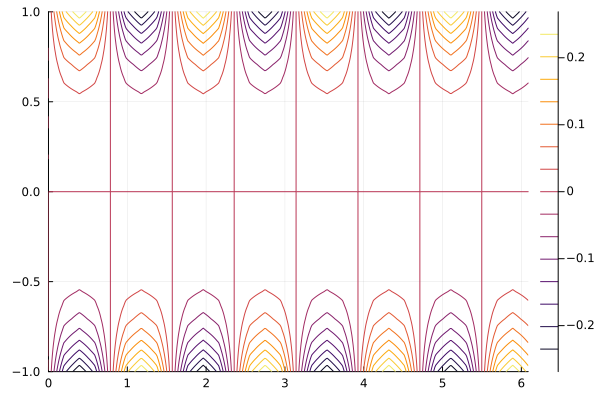

In [208]:
ugradw_hat = PseudoSpectral._convective_derivative_fourier_chebyshev(ω̂,ψ̂,D1);
ugradw = fourier2physical(ugradw_hat,1);
plot(x,reverse(y),transpose(reverse(ugradw,dims=2)))

In [186]:
ψ = fourier2physical(ψ̂,1);
u = transpose(D1*transpose(ψ));
ω2 = -transpose(D2*transpose(ψ))-fourier2physical(PseudoSpectral._dfhatdx_fourier(PseudoSpectral._dfhatdx_fourier(ψ̂)),1);


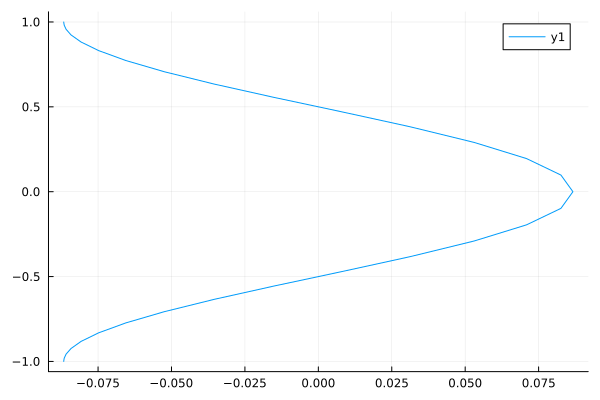

In [187]:
plot(u[4,:],y)

In [188]:
norm(ω-ω2)

6.903304951888108e-13

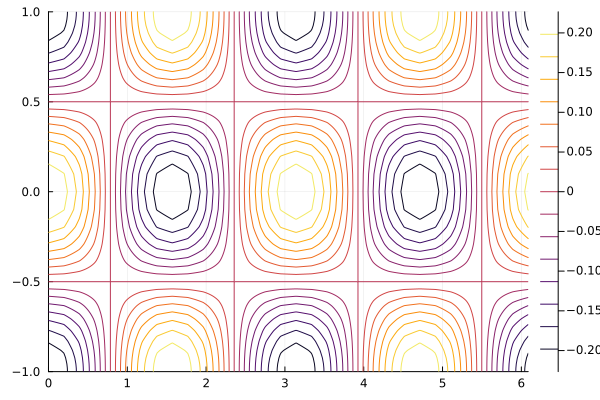

In [184]:
plot(x,reverse(y),transpose(reverse(u,dims=2)))

### Influence matrix

In [224]:
Nx, Ny = 192, 192

D1 = PseudoSpectral._construct_chebd1(Ny)
D2 = PseudoSpectral._construct_chebd2(Ny,D1);

x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny);

In [225]:
ϵ, θ = 1, 0.5
Re = 2000;
Δt = 0.002;

In [270]:
f = zeros(ComplexF64,Ny+1);
hplus, hminus = ones(Nx), zeros(Nx)
gplus, gminus = 2*ones(Nx), zeros(Nx)

hplus_hat = physical2fourier(hplus)
hminus_hat = physical2fourier(hminus);

gplus_hat = physical2fourier(gplus)
gminus_hat = physical2fourier(gminus);

In [227]:
kx, kxsq = PseudoSpectral._get_ksq_shifted_1d(Nx);

In [274]:
k = 1
σ = kxsq[k] + (1+ϵ)/(2*θ*Δt/Re)

2.0e6

In [275]:
w, ψ = PseudoSpectral._vorticity_and_streamfunction_chebyshev_k(f,σ,kxsq[k],gplus_hat[k],gminus_hat[k],hplus_hat[k],hminus_hat[k],D1,D2);

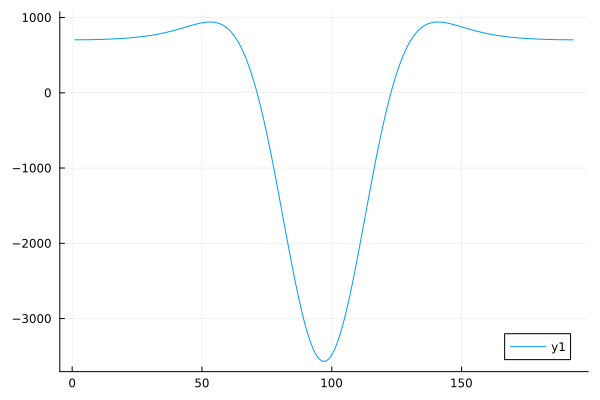

In [278]:
plot(fourier2physical(w))

In [253]:
w1 = PseudoSpectral._helmholtz_chebyshev_dirichlet(f,σ,gplus1,gminus1,D2);
w2 = PseudoSpectral._helmholtz_chebyshev_dirichlet(f,σ,gplus2,gminus2,D2);

psi1 = PseudoSpectral._helmholtz_chebyshev_dirichlet(-w1,kxsq[3],0,0,D2);
psi2 = PseudoSpectral._helmholtz_chebyshev_dirichlet(-w2,kxsq[3],0,0,D2);

dpsi1 = D1*psi1
dpsi2 = D1*psi2;

In [254]:
M = [dpsi1[1] dpsi2[1]; dpsi1[Ny+1] dpsi2[Ny+1]]

2×2 Matrix{ComplexF64}:
 -0.000706106+0.0im   -3.6646e-8+0.0im
    3.6646e-8+0.0im  0.000706106+0.0im

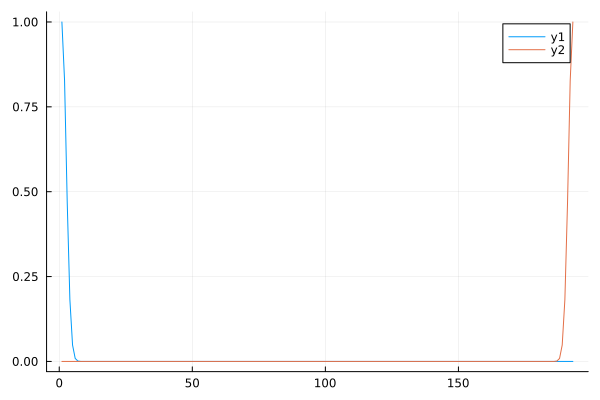

In [247]:
plot(real(w1))
plot!(real(w2))

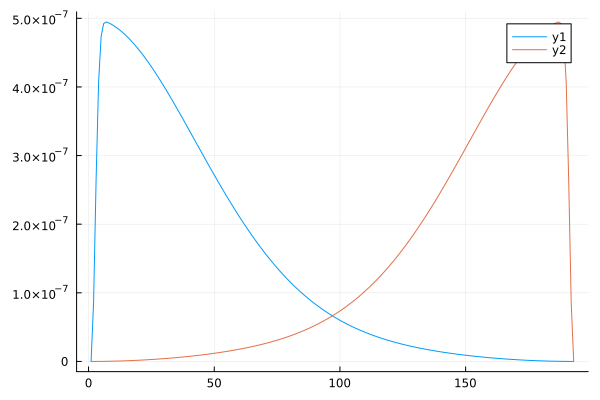

In [248]:
plot(real(psi1))
plot!(real(psi2))

### Solve

In [108]:
Nx, Ny = 128, 128
Re = 100.0
Δt = 0.05

x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny)

gplus, gminus = 2.0, 0.0
hplus, hminus = 0.0,0.0
params = VorticityFourierChebyshevNSCache(Nx,Ny,Re,Δt,gplus,gminus,hplus,hminus);

In [109]:
w0 = zeros(Nx,Ny+1)
psi0 = zeros(Nx,Ny+1);

what0 = physical2fourier(w0,1)
psihat0 = physical2fourier(psi0,1);

what = copy(what0)
psihat = copy(psihat0);

In [152]:
what_old = copy(what) 
for jt in 1:20
    vorticity_fc_ns_step!(what,psihat,params);
end
norm(what-what_old)/norm(what_old)

0.001555570447863816

In [153]:
w = fourier2physical(what,1);

uhat = PseudoSpectral._u_velocity_from_streamfunction_chebyshev(psihat,params.D1)
vhat = PseudoSpectral._v_velocity_from_streamfunction_fourier(psihat)
u = fourier2physical(uhat,1);
v = fourier2physical(vhat,1);

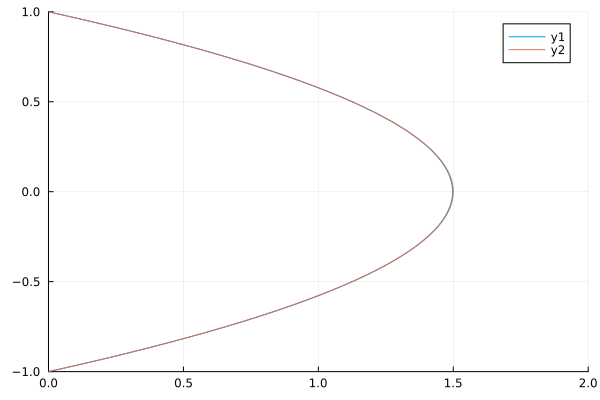

In [155]:
plot(u[1,:],y,xlim=(0,2),ylim=(-1,1))
plot!(3/2*(1 .- y.^2),y)

In [157]:
#what_ss = copy(what)
#psihat_ss = copy(psihat);

#what_ss = 

In [235]:
Nx, Ny = 128, 128
Re = 5000.0
Δt = 0.002

x = range(0,2π,length=Nx+1)[1:Nx]
y = cos.(π*(0:Ny)/Ny)

gplus, gminus = 2.0, 0.0
hplus, hminus = 0.0,0.0
params = VorticityFourierChebyshevNSCache(Nx,Ny,Re,Δt,gplus,gminus,hplus,hminus);

w_perturb = randomfield_fourier_chebyshev(x,y,factor=0.1);
what_perturb = physical2fourier(w_perturb,1);

what = what_perturb #copy(what_ss) + what_perturb;
psihat = zero(what); #copy(psihat_ss);

In [237]:
w = fourier2physical(what,1);

uhat = PseudoSpectral._u_velocity_from_streamfunction_chebyshev(psihat,params.D1)
vhat = PseudoSpectral._v_velocity_from_streamfunction_fourier(psihat)
u = fourier2physical(uhat,1);
v = fourier2physical(vhat,1);

ωhistory = [copy(fourier2physical(what,1))];
t = 0.0
thistory = [t];

In [344]:
for kt in 1:10
    for jt in 1:20
        vorticity_fc_ns_step!(what,psihat,params);
        t += Δt
    end
    push!(ωhistory,copy(fourier2physical(what,1)))
    push!(thistory,t)
end

In [349]:
w = fourier2physical(what,1);

uhat = PseudoSpectral._u_velocity_from_streamfunction_chebyshev(psihat,params.D1)
vhat = PseudoSpectral._v_velocity_from_streamfunction_fourier(psihat)
u = fourier2physical(uhat,1);
v = fourier2physical(vhat,1);

In [350]:
maximum(abs.(w))

1000.0785191703527

In [351]:
what_mean = copy(what);
what_mean[2:end,:] .= 0.0;
psihat_mean = copy(psihat);
psihat_mean[2:end,:] .= 0.0;
uhat_mean = PseudoSpectral._u_velocity_from_streamfunction_chebyshev(psihat_mean,params.D1)
vhat_mean = PseudoSpectral._v_velocity_from_streamfunction_fourier(psihat_mean)
u_mean = fourier2physical(uhat_mean,1);
v_mean = fourier2physical(vhat_mean,1);

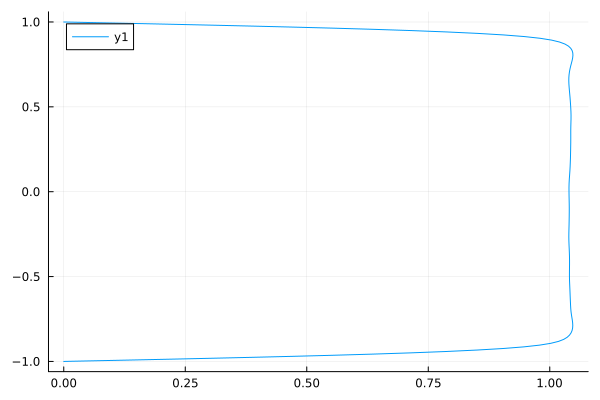

In [352]:
plot(u_mean[1,:],y)

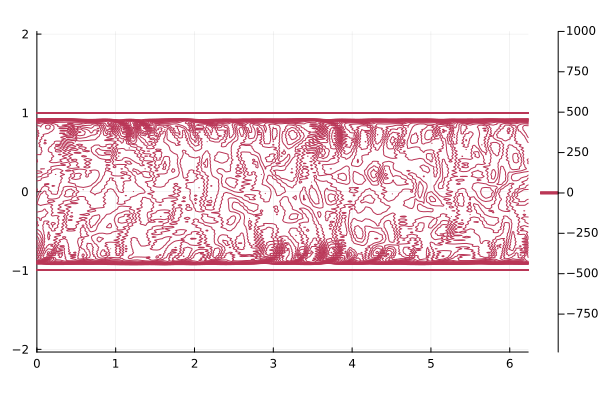

In [353]:
contour(x,reverse(y),transpose(reverse(w,dims=2)),ratio=1,levels=range(-5,5,length=30))

[ Info: Saved animation to /Users/jeff/JuliaProjects/PseudoSpectral/notebook/tmp.gif


Plots.AnimatedGif("/Users/jeff/JuliaProjects/PseudoSpectral/notebook/tmp.gif")
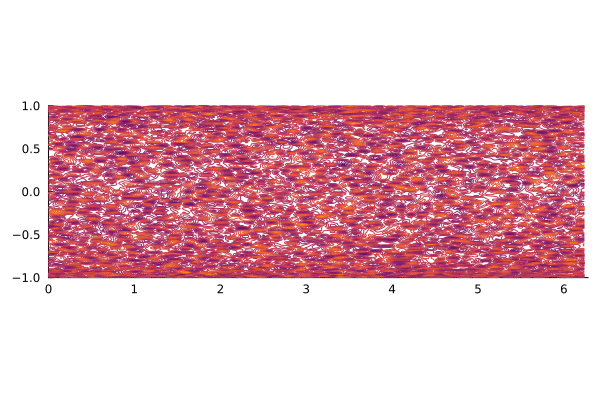

In [354]:
@gif for ωj in ωhistory[1:end]
    plot(x,reverse(y),transpose(reverse(ωj,dims=2)),ratio=1, xlim=(0,2π),ylim=(-1,1),clim=(-5,5),levels=range(-5,5,length=30),legend=false)
end every 1

In [228]:
size(ωhistory)

(61,)

In [229]:
60*20*Δt

2.4

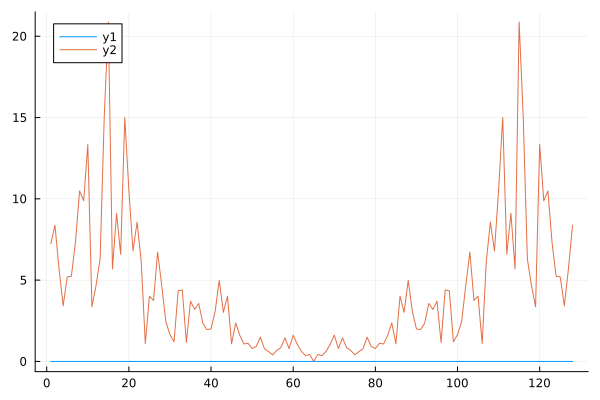

In [337]:
plot(abs.(what0[:,100]))
plot!(abs.(what[:,100]))